In [1]:
import dmyplant2
import arrow
from tabulate import tabulate
import traceback

import pandas as pd
import numpy as np
from pprint import pprint as pp
from bokeh.plotting import figure, output_file, output_notebook, show

import sys
import warnings
warnings.simplefilter(action='ignore', category=pd.errors.PerformanceWarning)


dmyplant2.cred()
mp = dmyplant2.MyPlant(600)

### Step 1: please insert the interesting Engine's SerialNumber below

In [2]:
# --------------------------vvvvvvv
e = dmyplant2.Engine_SN(mp, 1415409)
print(e)
pp(e.dash)
dtrips = e.batch_hist_alarms(p_severities=[800], p_offset=0, p_limit=10)
dtrips['datetime'] = pd.to_datetime(dtrips['timestamp'] * 1000000.0).dt.strftime("%m-%d-%Y %H:%m")
print(tabulate(dtrips[['datetime', 'message', 'name','severity']]))

1415409 M01 SALMMEIR BVBA          
{'BMEP': 24.5,
 'Count_OpHour': 10607,
 'Design Number': 'Y809',
 'Engine ID': 'M01',
 'Engine Type': '624',
 'Engine Version': 'K01',
 'LOC': 0.0125,
 'Name': 'SALMMEIR BVBA',
 'P': 24,
 'P_nom': 4584.1,
 'id': 133716,
 'oph parts': 3736,
 'oph@start': 6871,
 'serialNumber': '1415409',
 'val start': Timestamp('2020-10-21 00:00:00')}
-  ----------------  -------------------------------------------------------------------  ----  ---
0  03-23-2021 13:03  Module interface panel circuit breaker tripped                       1140  800
1  03-23-2021 13:03  Module control panel circuit breaker tripped                         1139  800
2  03-22-2021 07:03  Collective trip: Software module reports critical parameter failure  2000  800
3  03-22-2021 06:03  Fail safe loop tripped                                               1056  800
4  03-22-2021 06:03  Emergency stop / safety loop                                         1031  800
5  03-22-2021 06:03  Earthin

### Step2: remove the comment on the rows below to see available ItemIds for plotting, copy as required

In [28]:
import pandas as pd
from tabulate import tabulate
from pprint import pprint as pp

class RequestID():
    df = None
    def load_csv(self, filename):
        self.df = pd.read_csv(filename, sep=';', encoding='utf-8')
    
    def load_dict(self, dat):
        self.df = pd.DataFrame([[k]+v for k,v in dat.items()],columns=['ID','myPlantName','unit'])

    def get_dict(self):
        return {rec['ID']:[rec['myPlantName'], rec['unit']] for rec in self.df.to_dict('records')}

    def unit(self,name):
        return self.df[self.df['myPlantName'] == name]

    def unit(self,id):
         return self.df[self.df['ID'] == id]

r = RequestID()
r.load_csv('DataItems_Request.csv')
print(r.df)
datall = r.get_dict()
#pp(datall)
print(r.unit('Exhaust_TempCylAvg'))
print(r.unit(52))

#Request_Ids = pd.read_csv('DataItems_Request.csv', sep=';', encoding='utf-8')
#print(tabulate(Request_Ids))
#datall = {rec['ID']:[rec['myPlantName'], rec['unit']] for rec in Request_Ids.to_dict('records')}
#pp(datall)

        ID                    myPlantName      unit
0       52             Exhaust_TempCylAvg  C (high)
1      103  Various_Values_PosTurboBypass         %
2    19079               Exhaust_TCSpeedA  1000/min
3    19080               Exhaust_TCSpeedB  1000/min
4       89                 TecJet_Lambda1       a/f
..     ...                            ...       ...
128  16610              Ignition_ITPCyl20       °KW
129  16611              Ignition_ITPCyl21       °KW
130  16612              Ignition_ITPCyl22       °KW
131  16613              Ignition_ITPCyl23       °KW
132  16614              Ignition_ITPCyl24       °KW

[133 rows x 3 columns]
Empty DataFrame
Columns: [ID, myPlantName, unit]
Index: []
   ID         myPlantName      unit
0  52  Exhaust_TempCylAvg  C (high)


In [4]:
%%time
dat0 = {
    161: ['Count_OpHour', 'h'], 
    102: ['Power_PowerAct', 'kW'],
    217: ['Hyd_PressCrankCase', 'mbar'],
    16546: ['Hyd_PressOilDif', 'bar'],
    69: ['Hyd_PressCoolWat', 'bar'],
}

df0 = e.hist_data(
    itemIds= dat0, 
    p_from=arrow.get(e.val_start).to('Europe/Vienna'), 
    p_to=arrow.now('Europe/Vienna'),
    timeCycle=30,
    slot=10
)

# Set Type of time column to DateTime
df0['Oph_parts'] = df0.Count_OpHour - e.oph_start

  0%|          | 0/3 [00:00<?, ?it/s]
itemIds: {161, 16546, 69, 102, 217}, Shape=(482833, 7), from: 21.10.2020 - 02:00, to:   06.04.2021 - 17:26, loaded from ./data/1415409_30_10.hdf
20000it [00:00, 90452.38it/s]

itemIds: {161, 16546, 69, 102, 217}, Shape=(4, 7), from: 06.04.2021 - 17:26, to:   06.04.2021 - 17:28, added to ./data/1415409_30_10.hdf
Wall time: 2.66 s


In [5]:

# Setup X Axis
x0 = arrow.get('2021-01-22 12:00:00').naive
x1 = arrow.get('2021-01-22 18:00:00').naive
df1 = df0[( df0.datetime >= x0 ) & ( df0.datetime <= x1 )]
#df1 = df0


# Setup Y Axis
dset = [
    {'col':['Hyd_PressCrankCase'],'ylim': (-100, 40),'unit':'mbar'},
    {'col':['Hyd_PressOilDif'],'ylim': (0, 5), 'unit':'bar'},
    {'col':['Hyd_PressCoolWat'],'ylim': (2, 3), 'unit':'bar'},
    {'col':['Power_PowerAct'], 'ylim':(0,5000), 'unit':'kW', 'color':'red'},
    {'col':['Oph_parts'], 'unit':'h'}
]
dset = [
    {'col':['Hyd_PressCrankCase'],'ylim': (-100, 40)},
    {'col':['Hyd_PressOilDif'],'ylim': (0, 5)},
    {'col':['Hyd_PressCoolWat'],'ylim': (2, 3)},
    {'col':['Power_PowerAct'], 'ylim':(0,5000)},
    {'col':['Oph_parts']}
]
dmyplant2.dbokeh_chart(
    df0, dset, title = e, figsize=(14,8))

Loading BokehJS ...

LOC, all available data received,
start 03.12.2019 val start 21.10.2020
Wall time: 994 ms


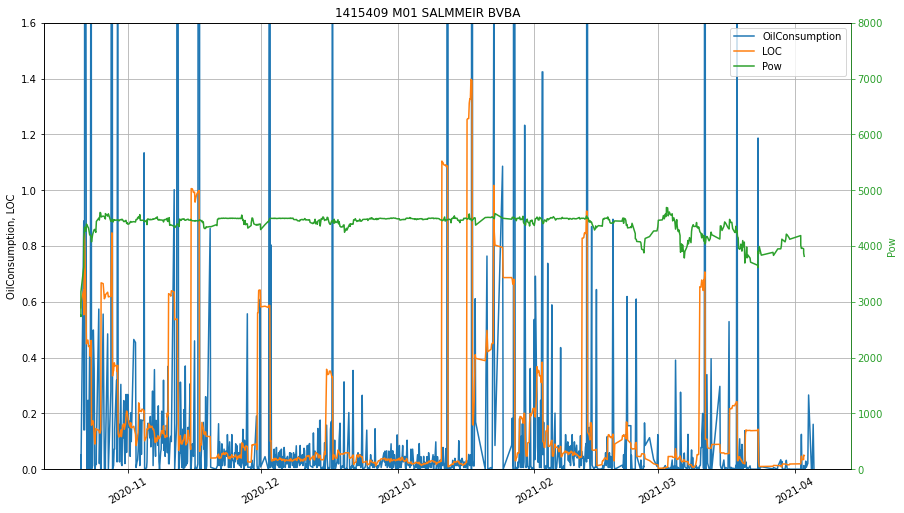

In [6]:
%%time
# Lube Oil Consuption data
dloc = e.Validation_period_LOC()

dmyplant2.chart(dloc, [
    {'col': ['OilConsumption','LOC'],'ylim': (0,1.6)},
    {'col': ['Pow'],'ylim': (0,8000)},
],
title = e,
figsize = (14,8))